## Just fit two Machine Learning models for my video
- linear regression model
- decision tree model


- x1: weight (carat)
- x2: clarity (8 types)
- y: price of diamonds

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn import datasets, linear_model, tree

In [3]:
df_diamonds = sns.load_dataset('diamonds')

In [4]:
df_diamonds.sample(5)

,carat,cut,color,clarity,depth,table,price,x,y,z
18211,1.00,Premium,E,VS1,58.7,62.0,7392,6.60,6.55,3.86
51050,0.61,Ideal,G,VVS2,62.4,53.8,2331,5.42,5.45,3.39
6704,0.36,Premium,J,SI1,61.6,60.0,410,4.54,4.58,2.81
32068,0.33,Ideal,D,SI1,62.4,54.0,780,4.44,4.41,2.76
11454,0.80,Ideal,E,VS1,61.8,56.0,5007,5.92,5.96,3.67


In [12]:
from sklearn.preprocessing import OrdinalEncoder
encoder = OrdinalEncoder()
X1 = df_diamonds[["carat"]].to_numpy()
X2 = encoder.fit_transform(df_diamonds[["cut"]])
Y = df_diamonds[["price"]].to_numpy()

In [18]:
X = np.hstack([X1, X2])
print(X.shape)

(53940, 2)


In [23]:
from sklearn.metrics import mean_absolute_error, r2_score

In [24]:
# init a linear regression model and decision tree model
lm = linear_model.LinearRegression()
dt = tree.DecisionTreeRegressor()

# fit linear models and decision tree models
lm = lm.fit(X, Y)
dt = dt.fit(X, Y)

In [83]:
print(lm.intercept_, lm.coef_, lm.score(X, Y))

[-2492.2966081] [[7752.9543248    93.50003872]] 0.8499105045930101


In [29]:
# get prediction results
Y_lm_pred = lm.predict(X)
Y_dt_pred = dt.predict(X)

# get metrics
print(mean_absolute_error(Y, Y_lm_pred))
print(r2_score(Y, Y_lm_pred))
print()
print(mean_absolute_error(Y, Y_dt_pred))
print(r2_score(Y, Y_dt_pred))

1008.3019763186461
0.8499105045930101

754.0536534771949
0.8896716264669918


In [40]:
print(X1.min())
print(X1.max())
print()
print(X2.min())
print(X2.max())

0.2
5.01

0.0
4.0


In [74]:
x1_arr = np.arange(0.0, 5.02, 0.01)
x2_arr = np.arange(0.0, 4.1, 0.01)

In [75]:
x1_grid, x2_grid = np.meshgrid(x1_arr, x2_arr)
print(x1_grid.shape)

(410, 502)


In [76]:
Y_lm_pred_grid = np.zeros(x1_grid.shape)
Y_dt_pred_grid = np.zeros(x1_grid.shape)

In [77]:
for i in range(x1_grid.shape[0]):
    for j in range(x2_grid.shape[1]):
        _x1 = x1_grid[i, j]
        _x2 = x2_grid[i, j]
        _x = np.array([_x1, _x2]).reshape(1, -1)
        
        Y_lm_pred_grid[i, j] = lm.predict(_x)
        Y_dt_pred_grid[i, j] = dt.predict(_x)

In [119]:
import plotly.graph_objects as go
import plotly.express as px
import plotly

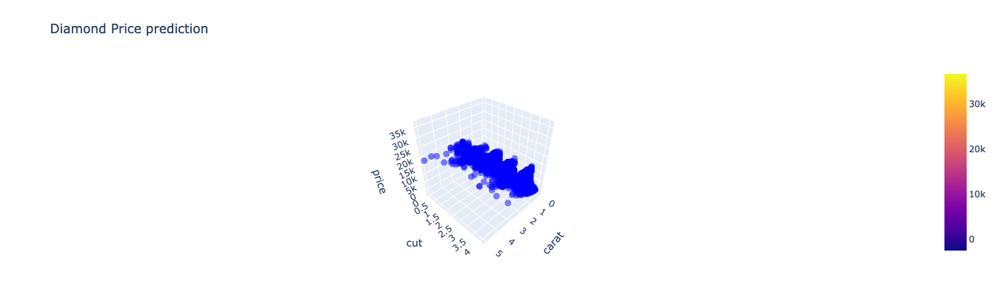

In [159]:
fig = go.Figure(
    data = [
        go.Surface(
            x=x1_grid,
            y=x2_grid,
            z=Y_lm_pred_grid
        ),
        go.Scatter3d(
            x=X1.flatten(),
            y=X2.flatten(),
            z=Y.flatten(),
            opacity=0.5,
            mode="markers",
            marker={
                "size": 5,
                "color": "blue",
            }
        )
    ]
)

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.5, y=1.5, z=1.5)
)

fig.update_layout(
    title='Diamond Price prediction',
    autosize=False,
    width=600, height=600,
    margin=dict(l=65, r=40, b=65, t=90),
    scene = dict(
        xaxis_title='carat',
        yaxis_title='cut',
        zaxis_title='price'),
    showlegend=False,
    scene_camera=camera
)

fig.update_coloraxes(showscale=False)
fig.update(
    layout_coloraxis_showscale=False,
    layout_showlegend=False)

fig.show()

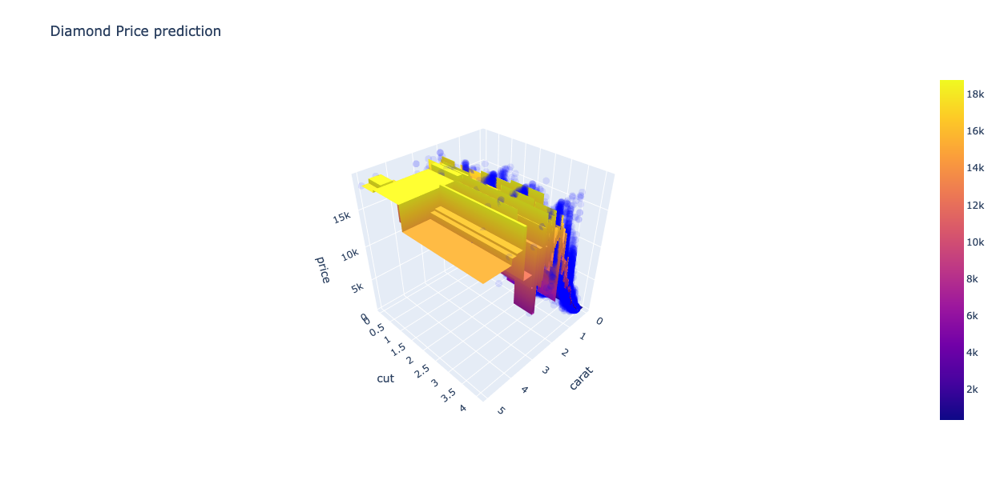

In [158]:
fig = go.Figure(
    data=[
        go.Surface(
            x=x1_grid,
            y=x2_grid,
            z=Y_dt_pred_grid),
        go.Scatter3d(
            x=X1.flatten(),
            y=X2.flatten(),
            z=Y.flatten(),
            opacity=0.1,
            mode="markers",
            marker={
                "size": 5,
                "color": "blue"
            }
        )
    ]
)

fig.update_layout(
    title='Diamond Price prediction',
    autosize=False,
    width=600, height=600,
    margin=dict(l=65, r=40, b=65, t=90),
    scene = dict(
        xaxis_title='carat',
        yaxis_title='cut',
        zaxis_title='price'),
    showlegend=False,
    scene_camera=camera
)
fig.update(layout_coloraxis_showscale=False)
fig.show()